In [1]:
# Social Media Analytics for Business Intelligence - A1: Team Assignment
## Copyright © 2025 Team 3. All rights reserved.

## This code is part of the team assignment for Social Media Analytics for Business Intelligence and is intended for academic, research, or portfolio use. No part of this code may be reproduced, distributed, or used in commercial applications without explicit permission from the author.

### Author: Team 3
### Year: 2025

# Data Loading

To begin the analysis, the Amazon Fine Food Reviews dataset was downloaded using the kagglehub library, which ensured access to the most updated version. The dataset was loaded into a pandas DataFrame from the Reviews.csv file. This dataset contains over 568,000 user-generated reviews, each with metadata including product ID, user ID, review score, helpfulness votes, timestamps, and review text. Initial inspection revealed 10 key columns, with minor missing values in the ProfileName and Summary fields. Duplicate entries were evaluated at both row and text levels to ensure data integrity before proceeding to cleaning and analysis.

In [2]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("snap/amazon-fine-food-reviews")

print("Path to dataset files:", path)

C:\Users\Lenovo\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Path to dataset files: C:\Users\Lenovo\.cache\kagglehub\datasets\snap\amazon-fine-food-reviews\versions\2


In [3]:
import pandas as pd
import os

# Path where dataset was downloaded
path = kagglehub.dataset_download("snap/amazon-fine-food-reviews")

# Define path to the CSV file
csv_file = os.path.join(path, "Reviews.csv")

# Load the dataset
df = pd.read_csv(csv_file)

# Preview the first few rows
print(df.head())


   Id   ProductId          UserId                      ProfileName  \
0   1  B001E4KFG0  A3SGXH7AUHU8GW                       delmartian   
1   2  B00813GRG4  A1D87F6ZCVE5NK                           dll pa   
2   3  B000LQOCH0   ABXLMWJIXXAIN  Natalia Corres "Natalia Corres"   
3   4  B000UA0QIQ  A395BORC6FGVXV                             Karl   
4   5  B006K2ZZ7K  A1UQRSCLF8GW1T    Michael D. Bigham "M. Wassir"   

   HelpfulnessNumerator  HelpfulnessDenominator  Score        Time  \
0                     1                       1      5  1303862400   
1                     0                       0      1  1346976000   
2                     1                       1      4  1219017600   
3                     3                       3      2  1307923200   
4                     0                       0      5  1350777600   

                 Summary                                               Text  
0  Good Quality Dog Food  I have bought several of the Vitality canned d...  
1 

# Data Inspection

After loading the dataset, an initial data inspection was conducted to assess its structure and quality. The dataset contains 568,454 rows and 10 columns, including review text, summary, ratings (1–5), helpfulness scores, timestamps, and user/product identifiers. Missing values were minimal, with only 26 missing entries in the ProfileName column and 27 in the Summary column. Duplicate analysis revealed no entirely duplicated rows, but approximately 175,000 reviews were duplicated based on identical UserId and Text combinations. Additionally, around 58,000 unique review texts were repeated, affecting over 233,000 rows. The inspection also showed that many users and products had multiple entries—over 312,000 users submitted more than one review, and nearly 494,000 products received multiple reviews. These findings informed the subsequent data cleaning steps to ensure high-quality input for the analysis.

In [4]:
# Initial Inspection
# Dataset overview
print("Dataset Shape:", df.shape)
print("Column Names:", df.columns.tolist())

# Data types and non-null counts
print("\nData Info:")
df.info()

# Check missing values
print("\nMissing Values:")
print(df.isnull().sum())

# Preview sample data
df[['Id', 'ProductId', 'UserId', 'ProfileName', 'HelpfulnessNumerator', 'HelpfulnessDenominator', 'Score', 'Summary', 'Text']].sample(5, random_state=42)

Dataset Shape: (568454, 10)
Column Names: ['Id', 'ProductId', 'UserId', 'ProfileName', 'HelpfulnessNumerator', 'HelpfulnessDenominator', 'Score', 'Time', 'Summary', 'Text']

Data Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 568454 entries, 0 to 568453
Data columns (total 10 columns):
 #   Column                  Non-Null Count   Dtype 
---  ------                  --------------   ----- 
 0   Id                      568454 non-null  int64 
 1   ProductId               568454 non-null  object
 2   UserId                  568454 non-null  object
 3   ProfileName             568428 non-null  object
 4   HelpfulnessNumerator    568454 non-null  int64 
 5   HelpfulnessDenominator  568454 non-null  int64 
 6   Score                   568454 non-null  int64 
 7   Time                    568454 non-null  int64 
 8   Summary                 568427 non-null  object
 9   Text                    568454 non-null  object
dtypes: int64(5), object(5)
memory usage: 43.4+ MB

Missing Values:


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Summary,Text
165256,165257,B000EVG8J2,A1L01D2BD3RKVO,"B. Miller ""pet person""",0,0,5,Crunchy & Good Gluten-Free Sandwich Cookies!,Having tried a couple of other brands of glute...
231465,231466,B0000BXJIS,A3U62RE5XZDP0G,Marty,0,0,5,great kitty treats,My cat loves these treats. If ever I can't fin...
427827,427828,B008FHUFAU,AOXC0JQQZGGB6,Kenneth Shevlin,0,2,3,COFFEE TASTE,A little less than I expected. It tends to ha...
433954,433955,B006BXV14E,A3PWPNZVMNX3PA,rareoopdvds,0,1,2,So the Mini-Wheats were too big?,"First there was Frosted Mini-Wheats, in origin..."
70260,70261,B007I7Z3Z0,A1XNZ7PCE45KK7,Og8ys1,0,2,5,Great Taste . . .,and I want to congratulate the graphic artist ...


In [5]:
# Check for duplicate rows (entirely identical rows)
total_duplicates = df.duplicated().sum()
print(f"\nTotal Duplicate Rows (exact match): {total_duplicates}")

# Check for duplicate reviews based on UserId and Text
user_text_duplicates = df.duplicated(subset=['UserId', 'Text']).sum()
print(f"Duplicate reviews based on UserId and Text: {user_text_duplicates}")

# Duplicate UserIds – users who submitted more than one review
duplicate_users = df['UserId'].duplicated().sum()
print(f"Duplicate UserIds (multiple reviews by same user): {duplicate_users}")

# Duplicate ProductIds – products with multiple reviews
duplicate_products = df['ProductId'].duplicated().sum()
print(f"Duplicate ProductIds (products reviewed multiple times): {duplicate_products}")

# Count how many *unique* texts are duplicated
num_unique_duplicated_texts = df['Text'].value_counts()
num_unique_duplicated_texts = num_unique_duplicated_texts[num_unique_duplicated_texts > 1]
print(f"Number of unique duplicated review texts: {len(num_unique_duplicated_texts)}")

# Count how many *rows* have duplicated review texts
duplicated_text_rows = df['Text'].duplicated(keep=False).sum()
print(f"Total number of rows with duplicated review texts: {duplicated_text_rows}")

# Extract all rows where the 'Text' column is duplicated (keep=False returns all occurrences, not just one)
duplicated_text_df = df[df['Text'].duplicated(keep=False)]

# Sort by text for easier viewing
duplicated_text_df = duplicated_text_df.sort_values(by='Text')

# Preview the first few rows
duplicated_text_df[['UserId', 'ProductId', 'Score', 'Summary', 'Text']].head(10)



Total Duplicate Rows (exact match): 0
Duplicate reviews based on UserId and Text: 174848
Duplicate UserIds (multiple reviews by same user): 312395
Duplicate ProductIds (products reviewed multiple times): 494196
Number of unique duplicated review texts: 58040
Total number of rows with duplicated review texts: 232915


,UserId,ProductId,Score,Summary,Text
257785,A142S4ZZF1FJ1X,B000KOWR8E,4,Better Sweetener!,"""4C Totally Light"" is one of the very few ""sug..."
506745,A142S4ZZF1FJ1X,B000KOWR8Y,4,4C Totally Light,"""4C Totally Light"" is one of the very few ""sug..."
107704,A1R7E82MN0S8V3,B001F0RRTQ,5,GREAT DOG TREAT,"""BUFFY"" LOOKS FORWARD TO HER ""TOY"" EVERY AFTER..."
418609,A1R7E82MN0S8V3,B001F0RRU0,5,GREAT DOG TREAT,"""BUFFY"" LOOKS FORWARD TO HER ""TOY"" EVERY AFTER..."
561246,A7FNPP1SMY97G,B001JU81ZG,1,Buy this if you have NO taste buds!,"""Blends smooth and creamy for a sweet tasting ..."
330089,A7FNPP1SMY97G,B001OHX1ZY,1,Buy this if you have NO taste buds!,"""Blends smooth and creamy for a sweet tasting ..."
233264,A17950SQVNAVOD,B007TJGZ4A,1,Packaging quality problem,"""Both"" of Gloria Jean's ""Hazelnut"" and ""Vanill..."
473106,A17950SQVNAVOD,B008FHUKE6,1,Packaging quality problem,"""Both"" of Gloria Jean's ""Hazelnut"" and ""Vanill..."
245224,A17950SQVNAVOD,B0029XDZKI,1,Packaging quality problem,"""Both"" of Gloria Jean's ""Hazelnut"" and ""Vanill..."
425981,A17950SQVNAVOD,B000TQEWM2,1,Packaging quality problem,"""Both"" of Gloria Jean's ""Hazelnut"" and ""Vanill..."


# Data Pre-Processing

The data pre-processing phase focused on preparing the review text for analysis. This involved cleaning the raw text in the Text column by converting all characters to lowercase, removing punctuation and non-alphabetic characters, and eliminating common English stopwords using NLTK. A custom clean_text function was applied to generate a new Cleaned_Text column containing tokenized and standardized text. This step was crucial for downstream tasks such as feature extraction and sentiment analysis. Additionally, the dataset was trimmed to include the first 600,000 records to optimize performance. The cleaned data provided a consistent and noise-reduced foundation for analytical techniques like TF-IDF vectorization, topic modeling, and sentiment classification.

In [6]:
!pip install nltk

import re
import nltk
from nltk.corpus import stopwords

# Download NLTK stopwords (only once)
nltk.download('stopwords')

# Load English stopwords
stop_words = set(stopwords.words("english"))



[notice] A new release of pip is available: 24.0 -> 25.1.1
[notice] To update, run: C:\Users\Lenovo\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Lenovo\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [7]:
import re
from nltk.corpus import stopwords

stop_words = set(stopwords.words('english'))

def clean_text(text):
    text = text.lower()                                 # Lowercase
    text = re.sub(r"[^a-z\s]", "", text)                # Remove non-letters
    tokens = text.split()                               # Tokenize
    tokens = [t for t in tokens if t not in stop_words] # Remove stopwords
    return " ".join(tokens)

df['Cleaned_Text'] = df['Text'].astype(str).apply(clean_text)


In [8]:
# Apply to a subset first (adjust number as needed)
df = df.iloc[:600000].copy()
df['Cleaned_Text'] = df['Text'].apply(clean_text)

# Preview cleaned data
print(df[['Text', 'Cleaned_Text']].head())

# Preview sample data with Cleaned_Text from the subset
print(df[['Id', 'ProductId', 'UserId', 'ProfileName', 'HelpfulnessNumerator',
                 'HelpfulnessDenominator', 'Score', 'Summary', 'Cleaned_Text']].sample(5, random_state=42))

                                                Text  \
0  I have bought several of the Vitality canned d...   
1  Product arrived labeled as Jumbo Salted Peanut...   
2  This is a confection that has been around a fe...   
3  If you are looking for the secret ingredient i...   
4  Great taffy at a great price.  There was a wid...   

                                        Cleaned_Text  
0  bought several vitality canned dog food produc...  
1  product arrived labeled jumbo salted peanutsth...  
2  confection around centuries light pillowy citr...  
3  looking secret ingredient robitussin believe f...  
4  great taffy great price wide assortment yummy ...  
            Id   ProductId          UserId             ProfileName  \
165256  165257  B000EVG8J2  A1L01D2BD3RKVO  B. Miller "pet person"   
231465  231466  B0000BXJIS  A3U62RE5XZDP0G                   Marty   
427827  427828  B008FHUFAU   AOXC0JQQZGGB6         Kenneth Shevlin   
433954  433955  B006BXV14E  A3PWPNZVMNX3PA           

# Feature Engineering

In the feature engineering phase, several new variables were derived to enrich the dataset and support more insightful analysis. First, TF-IDF (Term Frequency–Inverse Document Frequency) vectorization was applied to the Cleaned_Text column to transform the textual data into a numerical format, limiting the vocabulary to the top 5,000 most relevant terms. A Sentiment label was also created by mapping review Score values into three categories: positive (scores 4–5), neutral (score 3), and negative (scores 1–2). To assess the credibility of user feedback, a Helpfulness_Ratio was calculated by dividing the HelpfulnessNumerator by the HelpfulnessDenominator, with results capped at 1. Additional features included ReviewLength and SummaryLength, representing the word counts of full reviews and summaries respectively, as well as ReviewAgeDays, which measured the age of each review in days based on the current timestamp. These engineered features provided critical inputs for sentiment and topic modeling, trend analysis, and user behavior profiling.

## TF-IDF Vectorization

In [9]:
!pip install scikit-learn

from sklearn.feature_extraction.text import TfidfVectorizer

# Limit vocabulary size for performance and remove common & rare words
tfidf = TfidfVectorizer(max_df=0.95, min_df=5, max_features=5000)

# Fit and transform the cleaned text
tfidf_matrix = tfidf.fit_transform(df['Cleaned_Text'])

# Check shape: (n_samples, n_features)
print("TF-IDF Matrix Shape:", tfidf_matrix.shape)


[notice] A new release of pip is available: 24.0 -> 25.1.1
[notice] To update, run: C:\Users\Lenovo\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


TF-IDF Matrix Shape: (568454, 5000)


## Create Sentiment Labels

In [10]:
def map_sentiment(score):
    if score <= 2:
        return "negative"
    elif score == 3:
        return "neutral"
    else:
        return "positive"

df['Sentiment'] = df['Score'].apply(map_sentiment)
df['Sentiment'].value_counts()

Sentiment
positive    443777
negative     82037
neutral      42640
Name: count, dtype: int64

## Helpfulness Ratio

In [11]:
# Avoid division by zero by replacing denominator 0 with 1
df['Helpfulness_Ratio'] = df['HelpfulnessNumerator'] / df['HelpfulnessDenominator'].replace(0, 1)

# Cap values at 1 (sometimes numerators > denominators due to data issues)
df['Helpfulness_Ratio'] = df['Helpfulness_Ratio'].clip(upper=1.0)


## Additional Features

In [12]:
df['ReviewLength'] = df['Text'].str.split().str.len()
df['SummaryLength'] = df['Summary'].str.split().str.len()
df['ReviewAgeDays'] = (pd.Timestamp.now().timestamp() - df['Time']) / (24 * 3600)

In [13]:
# Basic descriptive statistics for numerical columns
desc_stats = df.describe().T

# Display rounded summary
print("Descriptive Statistics:\n")
print(desc_stats.round(2))

# Display first 5 rows of df_clean
df.head()


Descriptive Statistics:

                           count          mean          std           min  \
Id                      568454.0  2.842275e+05    164098.68  1.000000e+00   
HelpfulnessNumerator    568454.0  1.740000e+00         7.64  0.000000e+00   
HelpfulnessDenominator  568454.0  2.230000e+00         8.29  0.000000e+00   
Score                   568454.0  4.180000e+00         1.31  1.000000e+00   
Time                    568454.0  1.296257e+09  48043312.33  9.393408e+08   
Helpfulness_Ratio       568454.0  4.100000e-01         0.46  0.000000e+00   
ReviewLength            568454.0  8.026000e+01        79.46  3.000000e+00   
SummaryLength           568427.0  4.110000e+00         2.60  1.000000e+00   
ReviewAgeDays           568454.0  5.266940e+03       556.06  4.630910e+03   

                                 25%           50%           75%           max  
Id                      1.421142e+05  2.842275e+05  4.263408e+05  5.684540e+05  
HelpfulnessNumerator    0.000000e+00  0.00

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,Cleaned_Text,Sentiment,Helpfulness_Ratio,ReviewLength,SummaryLength,ReviewAgeDays
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,bought several vitality canned dog food produc...,positive,1.0,48,4.0,5178.912356
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,product arrived labeled jumbo salted peanutsth...,negative,0.0,31,3.0,4679.912356
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,confection around centuries light pillowy citr...,positive,1.0,94,4.0,6160.912356
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,looking secret ingredient robitussin believe f...,negative,1.0,41,2.0,5131.912356
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,great taffy great price wide assortment yummy ...,positive,0.0,27,2.0,4635.912356


# Exploratory Data Analysis

## Foundational Distribution

The Exploratory Data Analysis (EDA) provided key insights into the distribution and patterns within the Amazon Fine Food Reviews dataset. Review scores were highly skewed towards positivity, with 78% of reviews labeled as positive, 14% as negative, and only 7.5% as neutral. Sentiment trends remained relatively stable over time, though minor fluctuations were observed in certain years. The average review length was approximately 80 words, while summaries averaged around 4 words. Longer reviews were generally associated with higher helpfulness ratios, suggesting that detailed feedback was perceived as more useful by other users. Additionally, certain products and users were significantly more active—some products received over 900 reviews, and some users contributed hundreds of reviews. Visualizations such as bar charts, histograms, scatter plots, and line graphs were used to illustrate relationships between variables like review length, sentiment, and helpfulness. These findings laid the groundwork for more advanced text mining techniques including sentiment analysis, topic modeling, and trend tracking.

### Score Distribution

The score distribution revealed a strong positive bias in customer reviews. Most ratings clustered at the upper end of the scale, with scores of 5 stars accounting for the majority, followed by 4-star ratings. In contrast, lower ratings (1 and 2 stars) were far less frequent. This skewed distribution suggests that customers are more inclined to leave feedback when they have had a positive experience, a common pattern in online reviews. The relatively low proportion of neutral (3-star) reviews indicates that customers may be more motivated to express clear satisfaction or dissatisfaction rather than moderate opinions. This polarization has implications for sentiment modeling, as the model may learn from imbalanced classes. It also suggests that businesses may perceive inflated satisfaction levels if they rely solely on average rating scores without deeper textual analysis. Thus, while the numerical score gives a broad indication of product reception, it is essential to complement it with qualitative insights from review text and helpfulness metrics for a more balanced understanding of customer sentiment.

In [14]:
import plotly.express as px

# Step 1: Count review scores (sorted 1 to 5)
score_counts = df['Score'].value_counts().sort_index()

# Step 2: Convert to DataFrame for Plotly
score_df = score_counts.reset_index()
score_df.columns = ['Score', 'Count']

# Step 3: Create bar chart
fig = px.bar(
    score_df,
    x='Score',
    y='Count',
    text='Count',
    color='Score',
    title='⭐️ Distribution of Review Scores (1 to 5)',
    template='plotly_white',
    color_continuous_scale='Blues'  # Optional color scale
)

# Step 4: Update layout and appearance
fig.update_traces(
    texttemplate='%{text:,}',
    textposition='outside'
)

fig.update_layout(
    xaxis_title='Review Score',
    yaxis_title='Number of Reviews',
    xaxis=dict(tickmode='linear', dtick=1),
    uniformtext_minsize=8,
    uniformtext_mode='hide',
    height=500
)

fig.show()


### Sentiment Distribution

The sentiment distribution, derived from review scores, revealed that the majority of customer feedback was overwhelmingly positive. Approximately 78% of reviews were classified as positive, while 14% were negative and only 7.5% were neutral. This imbalance reinforces the earlier observation from the score distribution that users are more likely to share positive experiences than negative or indifferent ones. Such sentiment skew may reflect genuine customer satisfaction, but it can also be influenced by review bias—where users with strong opinions (positive or negative) are more inclined to post feedback. The limited presence of neutral sentiment suggests that reviews are typically polarized, which has implications for modeling and interpretation. From a business intelligence perspective, the dominance of positive sentiment is encouraging but should be interpreted with caution, as it may mask underlying issues or outlier complaints that are valuable for quality improvement. Therefore, deeper analysis of textual content and helpfulness indicators is essential to extract actionable insights beyond surface-level positivity.

In [15]:
import pandas as pd
import plotly.express as px

# Step 1: Work on a clean subset from df (you can filter if needed)
df_clean = df.copy()

# Step 2: Count existing sentiment labels
sentiment_counts = df_clean['Sentiment'].value_counts().reindex(['positive', 'neutral', 'negative'])

# Step 3: Convert to DataFrame for Plotly
sentiment_df = sentiment_counts.reset_index()
sentiment_df.columns = ['Sentiment', 'Count']

# Step 4: Plot bar chart
fig = px.bar(
    sentiment_df,
    x='Sentiment',
    y='Count',
    color='Sentiment',
    text='Count',
    title='💬 Sentiment Distribution Based on Review Score',
    template='plotly_white',
    color_discrete_map={
        'positive': 'green',
        'neutral': 'gray',
        'negative': 'crimson'
    }
)

fig.update_layout(
    xaxis_title='Sentiment',
    yaxis_title='Number of Reviews',
    uniformtext_minsize=8,
    uniformtext_mode='hide'
)

fig.show()

# Step 5: Optional – Show sentiment percentages
sentiment_percentages = (
    df_clean['Sentiment']
    .value_counts(normalize=True)
    .reindex(['positive', 'neutral', 'negative']) * 100
).round(2)

# Display as a table
display(sentiment_percentages.to_frame(name='Percentage (%)'))


,Percentage (%)
Sentiment,
positive,78.07
neutral,7.50
negative,14.43


### Helpfulness Ratio Distribution

The analysis of the helpfulness ratio distribution highlighted a significant concentration of reviews with either very low or perfect helpfulness scores. Many reviews had a helpfulness ratio of 0, indicating that although feedback was submitted, it was not voted as helpful by other users. On the other end, a large portion of reviews had a perfect ratio of 1.0, suggesting that all users who voted found the review helpful. This bimodal distribution suggests that reviews are either clearly valuable or overlooked, with limited middle ground. Several factors may contribute to this trend, including review length, clarity, or timing. Notably, shorter or vague reviews may receive little engagement, while detailed and well-articulated feedback is more likely to be rated positively. These findings imply that helpfulness votes can serve as a proxy for review quality and influence, making the helpfulness ratio a useful feature for prioritizing customer insights. However, it also reflects user participation limitations, as many reviews remain unrated—potentially distorting the perceived value of certain feedback.


[notice] A new release of pip is available: 24.0 -> 25.1.1
[notice] To update, run: C:\Users\Lenovo\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


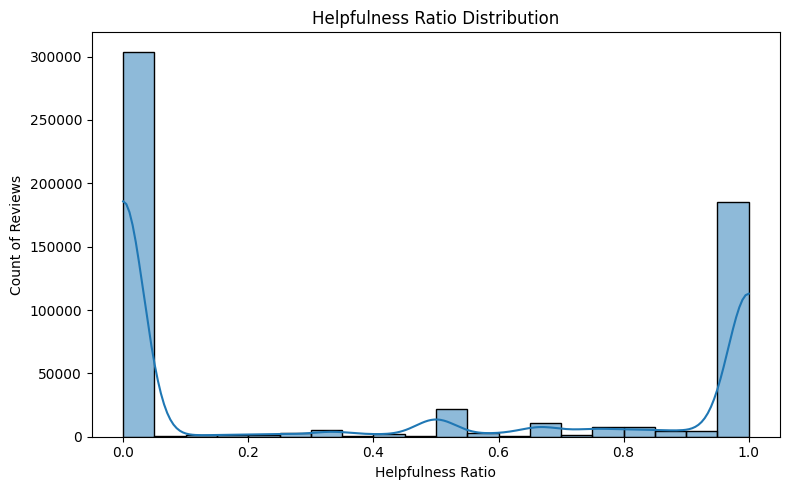

In [16]:
!pip install matplotlib seaborn

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(8, 5))
sns.histplot(
    data=df,
    x='Helpfulness_Ratio',
    bins=20,
    kde=True,
    hue=None
)
plt.title('Helpfulness Ratio Distribution')
plt.xlabel('Helpfulness Ratio')
plt.ylabel('Count of Reviews')
plt.tight_layout()
plt.show()

## Review Content Analysis

### Distribution of Review and Summary Lengths

The distribution of review and summary lengths revealed distinct patterns in how customers express their feedback. Full reviews had an average length of approximately 80 words, while summaries were much shorter, averaging just 4 words. The histogram showed that most reviews fell within the 20–150 word range, indicating a tendency for users to provide brief to moderately detailed narratives. In contrast, summaries were often limited to short phrases or single words, such as “Great” or “Not good,” offering minimal context. This sharp difference reflects the functional role of each field: the summary acts as a quick headline, while the main review contains detailed experiences or justifications. The longer the review, the more likely it is to be considered helpful, as observed in the correlation between review length and helpfulness ratio. These findings suggest that while summaries provide quick sentiment signals, meaningful insights and actionable feedback are predominantly embedded in the body of the review. As such, text analysis techniques should prioritize the full review text when extracting themes, sentiments, and product-specific concerns.

In [17]:
import pandas as pd
import plotly.graph_objects as go

# Step 1: Compute word counts (handles missing data)
df_clean['ReviewLength'] = df_clean['Text'].astype(str).apply(lambda x: len(x.split()))
df_clean['SummaryLength'] = df_clean['Summary'].astype(str).apply(lambda x: len(x.split()))

# Step 2: Compute average word lengths
avg_review_length = df_clean['ReviewLength'].mean()
avg_summary_length = df_clean['SummaryLength'].mean()

# Step 3: Print averages
print(f"📄 Average Review Length: {avg_review_length:.2f} words")
print(f"📝 Average Summary Length: {avg_summary_length:.2f} words")

# Step 4: Create histogram comparison
fig = go.Figure()

# Histogram for Review Text
fig.add_trace(go.Histogram(
    x=df_clean['ReviewLength'],
    name='Review Text',
    opacity=0.6,
    marker_color='skyblue',
    nbinsx=50
))

# Histogram for Summary Text
fig.add_trace(go.Histogram(
    x=df_clean['SummaryLength'],
    name='Summary Text',
    opacity=0.6,
    marker_color='orange',
    nbinsx=50
))

# Step 5: Customize layout
fig.update_layout(
    title='🧮 Distribution of Word Counts in Reviews vs. Summaries',
    xaxis_title='Word Count',
    yaxis_title='Frequency',
    barmode='overlay',  # overlays both histograms
    template='plotly_white',
    legend_title='Text Type',
    height=500
)

fig.update_xaxes(range=[0, max(df_clean['ReviewLength'].quantile(0.99), 
                               df_clean['SummaryLength'].quantile(0.99))])

fig.show()


📄 Average Review Length: 80.26 words
📝 Average Summary Length: 4.11 words


### Review Length vs Helpfulness

The relationship between review length and helpfulness revealed a positive correlation, indicating that longer reviews tend to receive higher helpfulness ratios. The scatter plot showed that as the number of words in a review increased, the likelihood of it being rated as helpful also rose, particularly up to a certain threshold. This suggests that users value detailed, informative reviews that provide context, reasoning, and personal experience. However, extremely long reviews did not always guarantee higher helpfulness, hinting at a diminishing return beyond a certain word count—possibly due to readability or user fatigue. Reviews that were too brief, on the other hand, often lacked enough substance to be considered useful by others. This insight underscores the importance of content quality and depth in user-generated feedback and reinforces the idea that platforms should encourage well-articulated reviews to enhance the collective value of their review systems. For businesses, this also means that helpful reviews—often longer and more detailed—can serve as valuable sources of customer insights.

In [18]:
import plotly.express as px

# Filter only reviews with denominator > 0
df_helpful = df[df['HelpfulnessDenominator'] > 0].copy()

# Plot using Plotly, using existing columns
fig = px.scatter(
    df_helpful,
    x='ReviewLength',
    y='Helpfulness_Ratio',
    opacity=0.3,
    title='📝 Review Length vs. Helpfulness Ratio',
    labels={
        'ReviewLength': 'Review Length (Word Count)',
        'Helpfulness_Ratio': 'Helpfulness Ratio'
    },
    template='plotly_white'
)

fig.update_traces(marker=dict(size=4))
fig.update_layout(
    height=600,
    xaxis=dict(range=[0, df_helpful['ReviewLength'].quantile(0.99)]),
    yaxis=dict(range=[0, 1])
)

fig.show()

In [19]:
import pandas as pd
import plotly.express as px

# Ensure ReviewLength is calculated
df_clean['ReviewLength'] = df_clean['Text'].astype(str).apply(lambda x: len(x.split()))

# 1. Correlation between Review Length and Score
correlation = df_clean['ReviewLength'].corr(df_clean['Score'])
print(f"🔗 Correlation between review length and review score: {correlation:.4f}")

# 2. Box plot of Review Length by Score
fig = px.box(
    df_clean,
    x='Score',
    y='ReviewLength',
    color='Score',
    title='📦 Distribution of Review Length by Review Score',
    labels={
        'Score': 'Review Score',
        'ReviewLength': 'Review Length (Word Count)'
    },
    template='plotly_white',
    points='outliers'  # show individual outlier points
)

# 3. Customize layout
fig.update_layout(
    xaxis=dict(type='category'),
    yaxis=dict(range=[0, df_clean['ReviewLength'].quantile(0.99)]),  # Optional cap
    showlegend=False,
    height=500
)

fig.show()


🔗 Correlation between review length and review score: -0.0770


## User & Product Activity

### Most Reviewed Products or Users

The analysis of the most reviewed products and users highlighted patterns of engagement and product popularity within the dataset. Certain products, such as snack items and beverages, received over 900 reviews, making them clear standouts in terms of customer attention. This suggests either high sales volume or strong consumer motivation to share opinions about these items. On the user side, a small group of highly active reviewers contributed hundreds of reviews each, with the top user submitting over 450 reviews. These prolific reviewers may represent power users, frequent buyers, or individuals participating in incentive programs such as Amazon Vine. While their contributions enrich the dataset, they can also introduce bias if overrepresented in sentiment or topic modeling. The concentration of reviews around specific products and users indicates the presence of potential influencer effects and product-specific communities. For businesses, understanding which products draw the most feedback and identifying frequent reviewers can support targeted marketing strategies and customer engagement efforts.

In [20]:
import pandas as pd
import plotly.express as px

# 🔝 Top 10 Most Reviewed Products
top_products = (
    df['ProductId']
    .value_counts()
    .head(10)
    .reset_index()
    .rename(columns={'index': 'ProductId', 'ProductId': 'ReviewCount'})
)
print("🔝 Top 10 Most Reviewed Products:")
print(top_products.to_string(index=False))

# 🧑‍💻 Top 10 Most Active Reviewers (by ProfileName)
top_users = (
    df['ProfileName']
    .value_counts()
    .head(10)
    .reset_index()
    .rename(columns={'index': 'ProfileName', 'ProfileName': 'ReviewCount'})
)
print("\n🧑‍💻 Top 10 Most Active Reviewers (by ProfileName):")
print(top_users.to_string(index=False))

# 👥 Top 10 Reviewers by unique (UserId, ProfileName) combination
top_reviewers = (
    df.groupby(['UserId', 'ProfileName'])
    .size()
    .reset_index(name='ReviewCount')
)
top_10_reviewers = top_reviewers.sort_values(by='ReviewCount', ascending=False).head(10)

# 📊 Plot using Plotly
fig = px.bar(
    top_10_reviewers,
    x='ReviewCount',
    y='ProfileName',
    orientation='h',
    color='ReviewCount',
    color_continuous_scale='Magma',
    title='Top 10 Most Active Reviewers (by ProfileName)',
    labels={
        'ReviewCount': 'Number of Reviews',
        'ProfileName': 'Reviewer'
    },
    template='plotly_white'
)

fig.update_layout(
    yaxis=dict(autorange="reversed"),
    height=500
)

fig.show()


🔝 Top 10 Most Reviewed Products:
ReviewCount  count
 B007JFMH8M    913
 B0026RQTGE    632
 B002QWHJOU    632
 B002QWP89S    632
 B002QWP8H0    632
 B003B3OOPA    623
 B001EO5Q64    567
 B000VK8AVK    564
 B0026KNQSA    564
 B007M83302    564

🧑‍💻 Top 10 Most Active Reviewers (by ProfileName):
                           ReviewCount  count
                      C. F. Hill "CFH"    451
       O. Brown "Ms. O. Khannah-Brown"    421
                         Gary Peterson    389
Rebecca of Amazon "The Rebecca Review"    365
                                 Chris    363
                                 Linda    290
                                  John    261
                                  Mike    260
                                    c2    256
                                 Laura    253


### Review Length by Review Score

The boxplot depicting the distribution of review length by review score reveals subtle but meaningful differences in how customers express feedback across rating levels. Reviews with 3-star ratings had the longest median length, suggesting that users giving neutral feedback tend to elaborate more, possibly explaining their balanced stance. In contrast, 1-star and 5-star reviews, which represent polarized opinions, showed relatively shorter median lengths, indicating that highly emotional reactions—whether positive or negative—may be expressed more succinctly. All score groups exhibited a wide range of review lengths and a considerable number of outliers, with some reviews extending well beyond 100 words. This variability reflects the diverse reviewing behaviors among users, with some providing brief impressions and others offering detailed commentary. These insights are useful for tailoring text mining approaches, where medium-length reviews might contain more nuanced and informative sentiment.

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_12456\876724341.py:14: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




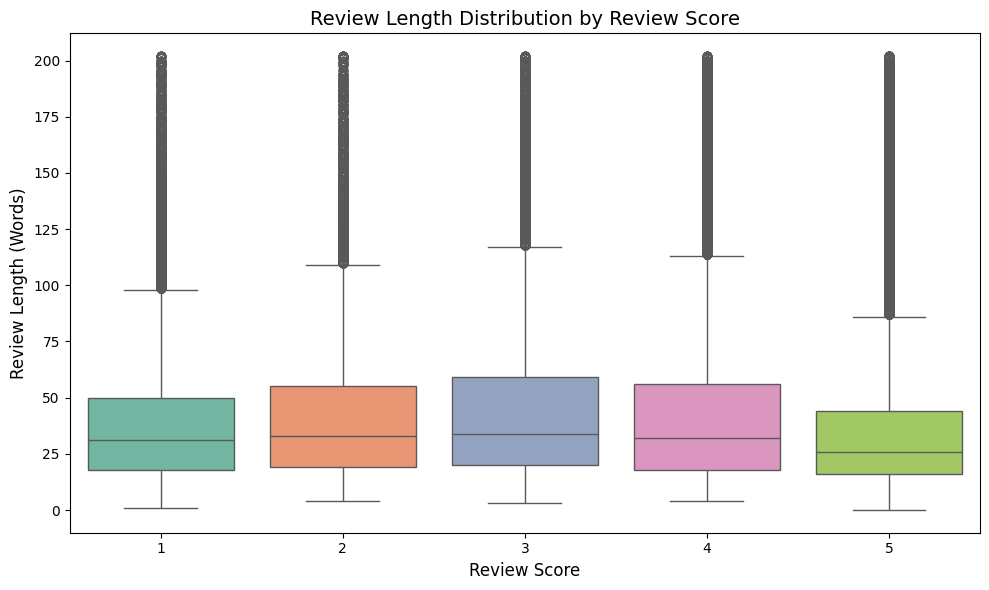

In [21]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Create ReviewLength column from Cleaned_Text
df['ReviewLength'] = df['Cleaned_Text'].astype(str).apply(lambda x: len(x.split()))

# Optional: Remove outliers beyond the 99th percentile
max_length = df['ReviewLength'].quantile(0.99)
df_filtered = df[df['ReviewLength'] <= max_length]

# Plot
plt.figure(figsize=(10, 6))
sns.boxplot(
    data=df_filtered,
    x='Score',
    y='ReviewLength',
    palette='Set2'
)

# Titles and labels
plt.title("Review Length Distribution by Review Score", fontsize=14)
plt.xlabel("Review Score", fontsize=12)
plt.ylabel("Review Length (Words)", fontsize=12)

plt.tight_layout()
plt.show()


### Average Score per User

The distribution of average scores per user provides insight into individual reviewing tendencies across the platform. Most users consistently gave high ratings, with the density plot peaking around 4.5 to 5, indicating that the majority of users rated products positively. Only a small proportion of users had an average rating below 3, suggesting that habitual negative reviewers were relatively rare. This reinforces the overall positivity bias observed in the dataset and suggests that customers are more inclined to share feedback when they are satisfied with their purchase. However, it also highlights the need for caution when interpreting average scores, as they may not reflect a balanced range of user experiences. For product teams, understanding reviewer behavior—especially from those with consistently high or low ratings—can help identify potential fan segments or persistent critics.

In [22]:
import pandas as pd
import plotly.figure_factory as ff

# Step 1: Compute average score per user
user_avg_scores = (
    df_clean
    .groupby(['UserId', 'ProfileName'])['Score']
    .mean()
    .reset_index()
    .rename(columns={'Score': 'AverageScore'})
)

# Step 2: Extract data, ensuring no NaNs
score_data = user_avg_scores['AverageScore'].dropna().tolist()

# Step 3: Create KDE plot
fig = ff.create_distplot(
    [score_data],
    group_labels=["User Average Scores"],
    show_hist=False,
    colors=['skyblue'],
    curve_type='kde'
)

# Step 4: Customize layout
fig.update_layout(
    title="📈 Distribution of Average Scores Given per User",
    xaxis_title="Average Score (1–5)",
    yaxis_title="Density",
    xaxis=dict(range=[1, 5], dtick=0.5),
    template='plotly_white',
    height=450
)

fig.show()


## Text and Sentiment Features

### Most Frequent Words

The word cloud visualization highlights the most common terms used in customer reviews, shedding light on key topics and sentiments expressed by users. Dominant phrases such as “grocery,” “store,” “highly,” “recommend,” “dog,” “food,” “green,” “tea,” “peanut,” “butter,” and “ive tried” suggest a strong focus on product types, usage experiences, and positive recommendations. The presence of phrases like “highly recommend,” “used,” “better,” and “much” reflects a trend toward evaluative and comparative language, indicating that users often benchmark products against alternatives. Additionally, frequent mentions of specific categories such as “dog food,” “cat food,” “peanut butter,” “green tea,” and “gluten free” point to popular items and dietary preferences among reviewers. These lexical patterns align with earlier sentiment findings, reinforcing the prevalence of satisfaction and product endorsement across the dataset. Overall, this type of word frequency analysis offers valuable insights into customer priorities and can inform product positioning, marketing language, and content optimization strategies.


[notice] A new release of pip is available: 24.0 -> 25.1.1
[notice] To update, run: C:\Users\Lenovo\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


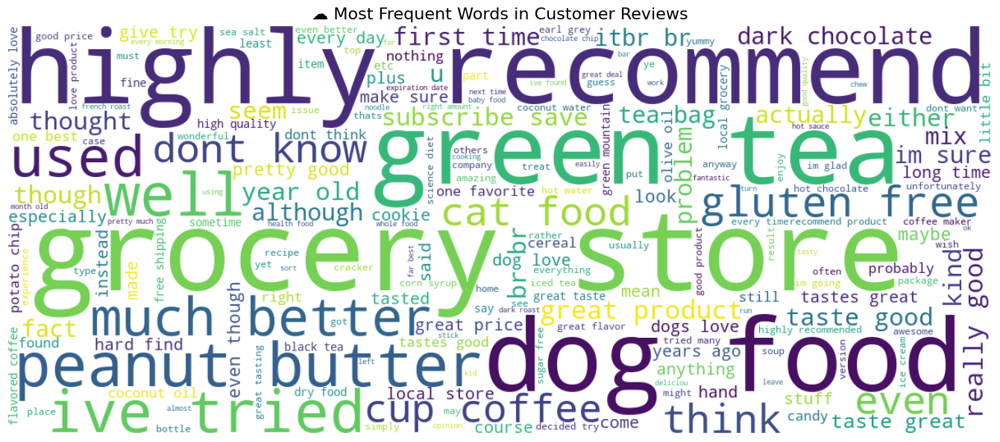

In [23]:
!pip install wordcloud matplotlib seaborn

import matplotlib.pyplot as plt
from wordcloud import WordCloud, STOPWORDS

# Join all cleaned reviews into one string
all_words = ' '.join(df['Cleaned_Text'].dropna())

# Generate word cloud
wordcloud = WordCloud(
    stopwords=STOPWORDS,
    width=1200,
    height=500,
    background_color='white',
    colormap='viridis',
    max_words=200
).generate(all_words)

# Plot the word cloud
plt.figure(figsize=(14, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('☁️ Most Frequent Words in Customer Reviews', fontsize=16)
plt.tight_layout()
plt.show()


### Helpfulness by Score

The bar chart shows a positive correlation between review scores and average helpfulness ratio, with helpfulness increasing steadily from 1-star to 5-star reviews. While lower-rated reviews (1 and 2 stars) had the lowest average helpfulness—around 0.53 and 0.57 respectively—helpfulness rose significantly for higher-rated reviews, reaching over 0.85 for 5-star ratings. This trend suggests that positive reviews are generally perceived as more helpful by the community, possibly due to their tone, clarity, or detailed descriptions of satisfaction. Interestingly, this contradicts the common assumption that mixed or critical reviews offer more informative content. Instead, it highlights that consumers may find reassurance and trust in detailed positive experiences. For businesses, this underscores the importance of encouraging satisfied customers to leave reviews, as they not only boost product ratings but are also more likely to influence other buyers through high perceived helpfulness.

In [24]:
import pandas as pd
import plotly.express as px

# Filter only reviews with HelpfulnessDenominator > 0
df_helpful = df[df['HelpfulnessDenominator'] > 0].copy()

# Calculate Helpfulness Ratio and cap it at 1.0
df_helpful['HelpfulnessRatio'] = (
    df_helpful['HelpfulnessNumerator'] / df_helpful['HelpfulnessDenominator']
).clip(upper=1.0)

# Group by review Score and calculate average Helpfulness Ratio
helpfulness_by_score = (
    df_helpful
    .groupby('Score', as_index=False)['HelpfulnessRatio']
    .mean()
    .sort_values('Score')
)

# Create a bar chart using Plotly
fig = px.bar(
    helpfulness_by_score,
    x='Score',
    y='HelpfulnessRatio',
    color='HelpfulnessRatio',
    color_continuous_scale='RdBu_r',
    title='🌟 Average Helpfulness Ratio by Review Score',
    labels={
        'Score': 'Review Score',
        'HelpfulnessRatio': 'Average Helpfulness Ratio'
    },
    template='plotly_white'
)

# Customize layout
fig.update_layout(
    yaxis=dict(range=[0, 1], title='Avg. Helpfulness Ratio'),
    xaxis=dict(tickmode='linear', title='Review Score'),
    coloraxis_colorbar=dict(title='Helpfulness'),
    height=500
)

fig.show()


### Sentiment Over Time

The yearly sentiment trend chart reveals a significant increase in review volume across all sentiment categories from 2006 onward, with positive reviews dominating each year. Notably, the number of positive reviews experienced exponential growth between 2010 and 2012, surpassing 150,000 reviews by 2012. Negative and neutral reviews also increased, but at a much slower rate, maintaining a distant second and third in volume. This trend highlights a growing user engagement with the platform and reinforces the strong positivity bias previously identified in the dataset.

The monthly sentiment trend provides insight into seasonal fluctuations in review activity. While monthly volumes remain relatively stable, a noticeable peak occurs in September and October, where the number of reviews surpasses 55,000. In contrast, November experiences a sharp drop, possibly due to seasonal factors or delayed product usage and review timing. These monthly patterns can help businesses align marketing campaigns, product launches, or review solicitation strategies with periods of higher customer activity and sentiment expression.

In [25]:
import plotly.express as px
import pandas as pd

# Step 1: Convert Unix timestamp to year (if not already done)
df['Review_Year'] = pd.to_datetime(df['Time'], unit='s').dt.year

# Step 2: Group by year and sentiment to get review counts
sentiment_by_year = (
    df.groupby(['Review_Year', 'Sentiment'])
    .size()
    .reset_index(name='Count')
)

# Step 3: Create line chart using Plotly
fig = px.line(
    sentiment_by_year,
    x='Review_Year',
    y='Count',
    color='Sentiment',
    markers=True,
    title='📈 Yearly Sentiment Trend',
    labels={
        'Review_Year': 'Year',
        'Count': 'Number of Reviews',
        'Sentiment': 'Sentiment Category'
    },
    template='plotly_white'
)

# Step 4: Customize layout
fig.update_layout(
    xaxis=dict(dtick=1),  # Ensure every year is shown
    yaxis_title='Number of Reviews',
    height=500
)

fig.show()

import pandas as pd
import plotly.express as px
import calendar

# Ensure 'Time' is in datetime format
df_clean['Time'] = pd.to_datetime(df_clean['Time'], unit='s', errors='coerce')

# Extract numeric month (1–12)
df_clean['Month'] = df_clean['Time'].dt.month

# Aggregate total reviews per month
monthly_reviews = df_clean['Month'].value_counts().sort_index()

# Map month numbers to names (ensure order)
month_names = [calendar.month_name[i] for i in monthly_reviews.index]

# Create DataFrame for plotting
monthly_df = pd.DataFrame({
    'MonthNumber': monthly_reviews.index,
    'Month': month_names,
    'ReviewCount': monthly_reviews.values
})

# Sort by MonthNumber to ensure correct order (Jan to Dec)
monthly_df = monthly_df.sort_values('MonthNumber')

# Plot line chart
fig = px.line(
    monthly_df,
    x='Month',
    y='ReviewCount',
    markers=True,
    title='📈 Monthly Sentiment Trend',
    labels={'Month': 'Month', 'ReviewCount': 'Number of Reviews'},
    template='plotly_white'
)

fig.update_traces(line=dict(width=3))
fig.update_layout(
    xaxis_tickangle=45,
    yaxis_title='Number of Reviews',
    xaxis_title='Month',
    height=500
)

fig.show()


## Correlation Heatmap

The correlation heatmap offers critical insights into customer review behavior, which directly supports the business objective of understanding feedback quality and customer sentiment. A very strong correlation (0.97) between HelpfulnessNumerator and HelpfulnessDenominator reflects that helpfulness votes are typically aligned, suggesting a shared perception of review value among customers. This insight can guide product teams to prioritize feedback that is widely endorsed by the community.

The moderate relationship between ReviewLength and SummaryLength (0.29) indicates that detailed reviewers tend to provide both comprehensive reviews and summaries. From a marketing perspective, this could inform the design of review prompts or incentives to encourage detailed, high-quality feedback.

Surprisingly, Score shows weak correlations with other variables, including review length and helpfulness, implying that high ratings do not always come with rich, useful content. This weak linkage emphasizes the business need to move beyond star ratings and analyze review text and helpfulness ratios to uncover nuanced customer perceptions and product pain points.

Moreover, ReviewAgeDays has near-zero correlation with other variables, suggesting that review patterns remain relatively stable over time—beneficial for trend forecasting and longitudinal sentiment tracking.

In summary, these correlations support a data-driven approach to product quality monitoring, customer sentiment analysis, and review credibility assessment—ultimately helping businesses better prioritize product improvements and tailor marketing strategies around authentic user feedback.



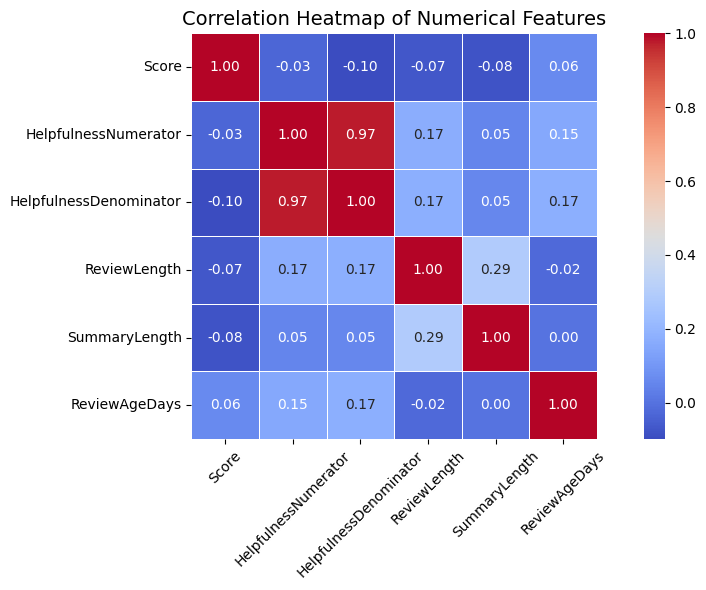

In [26]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# ✅ Define the numerical columns to include
corr_features = [
    'Score',
    'HelpfulnessNumerator',
    'HelpfulnessDenominator',
    'HelpfulnessRatio',
    'ReviewLength',
    'SummaryLength',
    'ReviewAgeDays',
    'vader_sentiment'
]

# ✅ Filter only existing columns to avoid KeyErrors
selected_columns = [col for col in corr_features if col in df.columns]

# ✅ Compute correlation matrix
corr_matrix = df[selected_columns].corr()

# 📊 Plot the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(
    corr_matrix,
    annot=True,
    cmap='coolwarm',
    fmt=".2f",
    linewidths=0.5,
    square=True
)
plt.title("Correlation Heatmap of Numerical Features", fontsize=14)
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()


## Time-Based Insights

### Temporal Trends

#### Temporal Sentiment Trends by Product

The monthly sentiment trends for the top 3 most reviewed products—identified by Product IDs B002QWHJOU, B002QWP89S, and B002QWP8H0—exhibit highly consistent patterns. Across all three products, positive sentiment clearly dominates, showing steady growth from 2008 through 2012, with noticeable peaks around late 2011 and mid-2012. This reflects strong and sustained customer satisfaction for these products over time. In contrast, negative and neutral reviews remained minimal, with only slight upticks appearing in late stages of the review timeline. These findings indicate that the top-reviewed products maintained a favorable reputation throughout their lifecycle, with very limited critical feedback. The sentiment stability across all three suggests that product quality, branding, or customer experience may have played a significant role in building long-term trust. For businesses, such sustained positive engagement serves as a benchmark for customer satisfaction and offers an opportunity to study what drives consistently high sentiment over time.

In [27]:
import pandas as pd
import plotly.express as px

# Step 1: Ensure 'Time' is datetime and filter valid entries
duplicated_text_df['Time'] = pd.to_datetime(duplicated_text_df['Time'], unit='s', errors='coerce')
duplicated_text_df = duplicated_text_df.dropna(subset=['Time'])

# Step 2: Create 'YearMonth' column
duplicated_text_df['YearMonth'] = duplicated_text_df['Time'].dt.to_period('M').astype(str)

# Step 3: Derive sentiment from Score
duplicated_text_df['Sentiment'] = duplicated_text_df['Score'].apply(
    lambda x: 'positive' if x > 3 else 'negative' if x < 3 else 'neutral'
)

# Step 4: Identify top 3 most reviewed products
top_products = duplicated_text_df['ProductId'].value_counts().nlargest(3).index.tolist()
df_top = duplicated_text_df[duplicated_text_df['ProductId'].isin(top_products)]

# Step 5: Aggregate sentiment counts by ProductId and YearMonth
trend_by_product = (
    df_top
    .groupby(['ProductId', 'YearMonth', 'Sentiment'])
    .size()
    .reset_index(name='Count')
)

# Step 6: Plot with Plotly
fig = px.line(
    trend_by_product,
    x='YearMonth',
    y='Count',
    color='Sentiment',
    facet_col='ProductId',
    facet_col_wrap=1,
    title='📈 Monthly Sentiment Trends for Top 3 Reviewed Products',
    labels={
        'YearMonth': 'Review Month',
        'Count': 'Number of Reviews',
        'Sentiment': 'Sentiment'
    },
    template='plotly_white',
    markers=True
)

# Step 7: Customize layout
fig.update_layout(
    height=800,
    showlegend=True,
    legend_title='Sentiment',
    title_font_size=16
)
fig.update_xaxes(tickangle=45)

fig.show()


#### Sentiment Proportions Over Time by Product

The sentiment proportion trends for the top three reviewed products—B002QWHJOU, B002QWP89S, and B002QWP8H0—show that positive sentiment consistently dominated, especially during the initial review periods when each product received 100% positive feedback. However, as review volume increased around 2009–2010, a more balanced distribution emerged. The proportion of positive reviews declined slightly but remained above 70%, while negative and neutral sentiments began to appear more regularly, each comprising roughly 10–15% of monthly sentiment. This shift likely reflects broader user exposure, with a growing number of diverse opinions contributing to the sentiment mix. The trends also highlight how product perception can evolve over time as more customers provide feedback, emphasizing the importance for businesses to continuously monitor sentiment—not just volume. Despite the slight dip in positivity, the sustained high proportion of favorable sentiment suggests enduring customer satisfaction with these products.

In [28]:
import pandas as pd
import plotly.express as px

# Step 1: Count sentiment-based reviews per product-month
sentiment_counts = (
    df_top
    .groupby(['ProductId', 'YearMonth', 'Sentiment'])
    .size()
    .reset_index(name='SentimentCount')
)

# Step 2: Count total reviews per product-month
monthly_totals = (
    df_top
    .groupby(['ProductId', 'YearMonth'])
    .size()
    .reset_index(name='TotalReviews')
)

# Step 3: Merge and compute sentiment proportion
sentiment_ratio = sentiment_counts.merge(monthly_totals, on=['ProductId', 'YearMonth'])
sentiment_ratio['Proportion'] = sentiment_ratio['SentimentCount'] / sentiment_ratio['TotalReviews']

# Optional: sort by time for cleaner line plots
sentiment_ratio = sentiment_ratio.sort_values(by='YearMonth')

# Step 4: Plot sentiment proportions over time by product
fig_ratio = px.line(
    sentiment_ratio,
    x='YearMonth',
    y='Proportion',
    color='Sentiment',
    facet_col='ProductId',
    facet_col_wrap=1,
    title='📊 Sentiment Proportion Over Time by Product',
    labels={
        'YearMonth': 'Month',
        'Proportion': 'Sentiment Proportion',
        'Sentiment': 'Sentiment Category'
    },
    markers=True,
    template='plotly_white'
)

# Step 5: Final layout tweaks
fig_ratio.update_layout(
    height=800,
    title_font_size=16,
    legend_title='Sentiment'
)
fig_ratio.update_xaxes(tickangle=45)

fig_ratio.show()


#### Average Helpfulness Ratio Over Time by Product

The chart displays the average monthly helpfulness ratio for the top three reviewed products—B002QWHJOU, B002QWP89S, and B002QWP8H0. Interestingly, all three product lines overlap on the same trend path, indicating they shared nearly identical helpfulness patterns over time. During the initial review periods, the helpfulness ratio frequently reached or approached 1.0, suggesting early reviews were perceived as highly useful by readers. However, as review activity increased, the helpfulness ratio began to fluctuate more widely, occasionally dropping below 0.5. These dips could be attributed to lower-quality or more repetitive reviews, reduced engagement with helpfulness voting, or a broader mix of reviewer perspectives. The repeated recovery of the ratio toward higher levels reflects that helpful content continued to emerge throughout the review lifecycle. The overlapping nature of the lines implies a consistent user perception of review quality across products, further validating the reliability of early product feedback and highlighting the importance of sustained review quality for maintaining customer trust.

In [29]:
import pandas as pd
import plotly.express as px

# Filter reviews with valid helpfulness scores
df_helpful = df_top[df_top['HelpfulnessDenominator'] > 0].copy()
df_helpful['HelpfulnessRatio'] = df_helpful['HelpfulnessNumerator'] / df_helpful['HelpfulnessDenominator']

# Average helpfulness ratio per product per month
helpfulness_trend = (
    df_helpful
    .groupby(['ProductId', 'YearMonth'])['HelpfulnessRatio']
    .mean()
    .reset_index()
)

# Ensure chronological order for better line plots
helpfulness_trend['YearMonth'] = pd.to_datetime(helpfulness_trend['YearMonth'])
helpfulness_trend = helpfulness_trend.sort_values(by='YearMonth')

# Plot using Plotly
fig_help = px.line(
    helpfulness_trend,
    x='YearMonth',
    y='HelpfulnessRatio',
    color='ProductId',
    title='👍 Average Helpfulness Ratio Over Time by Product',
    labels={
        'YearMonth': 'Month',
        'HelpfulnessRatio': 'Avg. Helpfulness Ratio',
        'ProductId': 'Product ID'
    },
    markers=True,
    template='plotly_white'
)

# 🛠️ Customize layout
fig_help.update_layout(
    height=500,
    xaxis_title='Month',
    yaxis_title='Average Helpfulness Ratio',
    xaxis_tickformat='%b %Y',
    xaxis_tickangle=45
)

fig_help.show()


#### Review Volume vs Helpfulness Ratio

The bubble chart illustrates the relationship between monthly review count (volume) and the average helpfulness ratio across the top three reviewed products. All data points for the products—B002QWHJOU, B002QWP89S, and B002QWP8H0—appear to overlap, forming a unified trend that suggests similar behavior in review quality across these items. The plot reveals that lower-volume months (under 10 reviews) often had very high helpfulness ratios, frequently near or at 1.0, implying that early or infrequent reviews were perceived as highly useful by readers. However, as review volume increased, the helpfulness ratio became more dispersed, ranging from as low as 0.2 to as high as 1.0. This indicates that while high review volume brings more engagement, it may also introduce variability in review quality or reader voting behavior. Larger bubbles clustered around moderate to high helpfulness ratios suggest that helpful reviews tend to persist even during periods of intense review activity. Overall, the chart emphasizes that high-quality feedback is not solely dependent on quantity, and a balanced review ecosystem benefits from both volume and perceived usefulness.

In [30]:
import pandas as pd
import plotly.express as px

# Step 1: Compute total reviews per product-month
volume = (
    df_top
    .groupby(['ProductId', 'YearMonth'])
    .size()
    .reset_index(name='TotalReviews')
)

# Step 2: Compute average helpfulness ratio per product-month
df_helpful = df_top[df_top['HelpfulnessDenominator'] > 0].copy()
df_helpful['HelpfulnessRatio'] = df_helpful['HelpfulnessNumerator'] / df_helpful['HelpfulnessDenominator']

helpfulness_trend = (
    df_helpful
    .groupby(['ProductId', 'YearMonth'])['HelpfulnessRatio']
    .mean()
    .reset_index()
)

# Step 3: Convert YearMonth to datetime to ensure consistency
volume['YearMonth'] = pd.to_datetime(volume['YearMonth'])
helpfulness_trend['YearMonth'] = pd.to_datetime(helpfulness_trend['YearMonth'])

# Step 4: Merge volume and helpfulness ratio data
volume_help = pd.merge(volume, helpfulness_trend, on=['ProductId', 'YearMonth'])

# Step 5: Create scatter plot
fig_volume_help = px.scatter(
    volume_help,
    x='TotalReviews',
    y='HelpfulnessRatio',
    color='ProductId',
    size='TotalReviews',
    title='Review Volume vs. Average Helpfulness Ratio by Product',
    labels={
        'TotalReviews': 'Review Count (Monthly)',
        'HelpfulnessRatio': 'Average Helpfulness Ratio',
        'ProductId': 'Product ID'
    },
    template='plotly_white',
    hover_data=['YearMonth']
)

# Step 6: Final plot adjustments
fig_volume_help.update_traces(opacity=0.7)
fig_volume_help.update_layout(
    height=500,
    legend_title='Product ID'
)

fig_volume_help.show()


#### Seasonal Sentiment Cycles by Product

The Seasonal Sentiment Cycle by Product chart illustrates monthly sentiment trends for the top three reviewed products—B002QWHJOU, B002QWP89S, and B002QWP8H0. Across all products and months, positive sentiment overwhelmingly dominates, with each product receiving the highest number of positive reviews in August, September, and October. This seasonal spike suggests heightened customer engagement or increased product usage and purchases during late summer and early autumn—possibly tied to seasonal demand, back-to-school shopping, or early holiday buying.

Conversely, negative and neutral reviews remained consistently low throughout the year, accounting for only a small fraction of total monthly reviews. The consistency of positive sentiment across all three products indicates strong customer satisfaction year-round, with no significant seasonal dips in brand perception.

Overall, the chart reveals that while volume increases seasonally, particularly in Q3, sentiment remains stably positive. This insight is valuable for brands planning product promotions, review solicitation, or sentiment monitoring—especially during seasonal peaks when visibility and feedback volume are at their highest.

In [31]:
import pandas as pd
import plotly.express as px
import calendar

# Step 1: Extract month number and full month name
df_top['Month'] = df_top['Time'].dt.month
df_top['MonthName'] = df_top['Month'].apply(lambda x: calendar.month_name[x])

# Step 2: Group by Product, Month, and Sentiment
seasonal_sentiment = (
    df_top
    .groupby(['ProductId', 'MonthName', 'Sentiment'])
    .size()
    .reset_index(name='Count')
)

# Step 3: Define correct month order (January to December)
month_order = list(calendar.month_name)[1:]

# Step 4: Create grouped bar chart
fig_seasonal = px.bar(
    seasonal_sentiment,
    x='MonthName',
    y='Count',
    color='Sentiment',
    facet_col='ProductId',
    category_orders={'MonthName': month_order},
    title='Seasonal Sentiment Cycle by Product',
    labels={
        'MonthName': 'Month',
        'Count': 'Number of Reviews',
        'Sentiment': 'Sentiment Category'
    },
    template='plotly_white'
)

# Step 5: Adjust layout
fig_seasonal.update_layout(
    height=700,
    legend_title='Sentiment'
)

fig_seasonal.show()


#### Compare Ratings Trends Alongside Sentiment

The chart compares the average review score (blue) and TextBlob sentiment polarity (red) over time for the top three reviewed products—B002QWHJOU, B002QWP89S, and B002QWP8H0. Across all products, review scores and sentiment polarity exhibit closely aligned patterns, reflecting consistent sentiment between the structured rating system and free-text review content.

Each product starts with a flat maximum score (5.0) and neutral polarity (0) due to limited early data. Around 2009, a noticeable drop in average scores occurs across all products, followed by recovery and stabilization within the 4.0–4.8 range. This suggests a brief period of mixed feedback or increased review diversity before overall satisfaction stabilized again. Correspondingly, average sentiment polarity begins to rise from zero, peaking around 0.3–0.4, and then maintains steady values, mirroring the recovery in review scores.

The alignment between numeric ratings and textual sentiment confirms that TextBlob polarity scores effectively track customer sentiment trends, and they can be used as a reliable proxy when star ratings are unavailable. The slight lag in polarity changes also suggests that text sentiment may reflect deeper nuances, offering earlier warnings or validations of shifting customer perceptions. This combined view helps brands detect shifts in sentiment quality and align their product or service improvements accordingly.

In [32]:
!pip install textblob

import pandas as pd
import plotly.express as px
from textblob import TextBlob

# Step 1: Compute TextBlob polarity for each review
df_top['Polarity'] = df_top['Text'].astype(str).apply(lambda x: TextBlob(x).sentiment.polarity)

# Step 2: Compute average review score per product per month
avg_score = (
    df_top
    .groupby(['ProductId', 'YearMonth'])['Score']
    .mean()
    .reset_index(name='AvgScore')
)

# Step 3: Compute average polarity per product per month
avg_polarity = (
    df_top
    .groupby(['ProductId', 'YearMonth'])['Polarity']
    .mean()
    .reset_index(name='AvgPolarity')
)

# Step 4: Merge the two metrics
combined_trend = pd.merge(avg_score, avg_polarity, on=['ProductId', 'YearMonth'])

# Step 5: Reshape for multi-line plotting
combined_melted = combined_trend.melt(
    id_vars=['ProductId', 'YearMonth'],
    value_vars=['AvgScore', 'AvgPolarity'],
    var_name='Metric',
    value_name='Value'
)

# Ensure YearMonth is datetime for proper axis handling
combined_melted['YearMonth'] = pd.to_datetime(combined_melted['YearMonth'])

# Step 6: Create line plot
fig_compare = px.line(
    combined_melted,
    x='YearMonth',
    y='Value',
    color='Metric',
    line_group='ProductId',
    facet_col='ProductId',
    facet_col_wrap=1,
    title='Average Review Score vs Sentiment Polarity Over Time',
    labels={
        'Value': 'Score / Polarity',
        'YearMonth': 'Month',
        'Metric': 'Metric'
    },
    template='plotly_white',
    markers=True
)

# Step 7: Layout adjustments
fig_compare.update_layout(
    height=800,
    legend_title='Metric'
)
fig_compare.update_xaxes(tickangle=45)

fig_compare.show()



[notice] A new release of pip is available: 24.0 -> 25.1.1
[notice] To update, run: C:\Users\Lenovo\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


# Analytical Techniques

## Sentiment Analysis

The sentiment analysis was conducted using the VADER (Valence Aware Dictionary and sEntiment Reasoner) tool, which classified reviews into positive, neutral, or negative sentiments. To assess its performance, we compared VADER’s predictions with the sentiment inferred from review scores using a confusion matrix and classification metrics.

The overall accuracy of the VADER sentiment classifier reached 79.6%, with a weighted average F1-score of 0.766, indicating a relatively high level of agreement between predicted sentiments and actual review scores. The performance was strongest in detecting positive sentiments, with a precision of 0.843, recall of 0.941, and F1-score of 0.890. In contrast, performance dropped substantially for neutral reviews, achieving a low precision of 0.128, recall of 0.039, and F1-score of 0.060. Negative reviews showed moderate performance with an F1-score of 0.465.

The confusion matrix highlights the model's tendency to overpredict positive sentiment. A significant number of actual neutral (33,049) and negative (33,037) reviews were misclassified as positive. This bias likely stems from the inherently positive tone of most product reviews, which skews the model's learning. While this behavior ensures high performance for capturing satisfied customers, it limits sensitivity to dissatisfaction or ambiguity, which may be critical for product improvement insights.

Although VADER excels in identifying positively framed content, it struggles with nuance—particularly in neutral or mixed reviews. This suggests that lexicon-based methods like VADER may benefit from augmentation with machine learning or transformer-based models for more balanced sentiment categorization. From a business perspective, this means that companies relying solely on such sentiment tools might underestimate negative feedback or overestimate satisfaction, impacting decision-making around product improvements and customer experience strategies.

In [33]:
import pandas as pd
import re
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from sklearn.metrics import confusion_matrix, classification_report
import plotly.figure_factory as ff

# Download VADER lexicon
nltk.download('vader_lexicon')

# Step 1: Work on a copy of the main DataFrame
df_vader = df.copy()

# Step 2: Normalize text (slang and emoji cleanup)
slang_dict = {
    "u": "you", "ur": "your", "omg": "oh my god", "lol": "laughing out loud",
    "idk": "i don't know", "luv": "love", "gr8": "great",
    ":)": "smile", ":-)": "smile", ":(": "sad", ":-(": "sad"
}

def normalize_text(text):
    text = str(text).lower()
    text = re.sub(r"http\S+|www.\S+", "", text)               # remove URLs
    text = re.sub(r"[^\x00-\x7F]+", " ", text)                # remove non-ASCII
    text = re.sub(r"[^a-z\s]", "", text)                      # remove punctuation and numbers
    words = text.split()
    normalized = [slang_dict.get(word, word) for word in words]
    return " ".join(normalized)

df_vader['Normalized_Text'] = df_vader['Text'].apply(normalize_text)

# Step 3: Initialize VADER
vader = SentimentIntensityAnalyzer()

# Step 4: Compute compound polarity score
df_vader['VADER_Score'] = df_vader['Normalized_Text'].apply(
    lambda x: vader.polarity_scores(x)['compound']
)

# Step 5: Classify sentiment based on VADER score
def classify_sentiment(score):
    if score >= 0.05:
        return 'positive'
    elif score <= -0.05:
        return 'negative'
    else:
        return 'neutral'

df_vader['VADER_Label'] = df_vader['VADER_Score'].apply(classify_sentiment)

# Step 6: Define ground truth sentiment from Score (1–5)
if 'Sentiment' not in df_vader.columns:
    df_vader['Sentiment'] = df_vader['Score'].apply(
        lambda x: 'positive' if x > 3 else 'negative' if x < 3 else 'neutral'
    )

# Step 7: Confusion matrix and labels
labels = ['positive', 'neutral', 'negative']
cm = confusion_matrix(df_vader['Sentiment'], df_vader['VADER_Label'], labels=labels)

# Step 8: Plot confusion matrix with Plotly
fig = ff.create_annotated_heatmap(
    z=cm,
    x=labels,
    y=labels,
    colorscale='Blues',
    showscale=True
)
fig.update_layout(
    title="Confusion Matrix: VADER Prediction vs. Review Score Sentiment",
    xaxis_title="Predicted (VADER)",
    yaxis_title="Actual (From Score)"
)
fig.show()

# Step 9: Print classification metrics
print("VADER Sentiment Classification Report:")
print(classification_report(
    df_vader['Sentiment'],
    df_vader['VADER_Label'],
    digits=3,
    zero_division=0
))


[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\Lenovo\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


VADER Sentiment Classification Report:
              precision    recall  f1-score   support

    negative      0.551     0.403     0.465     82037
     neutral      0.128     0.039     0.060     42640
    positive      0.843     0.941     0.890    443777

    accuracy                          0.796    568454
   macro avg      0.507     0.461     0.472    568454
weighted avg      0.747     0.796     0.766    568454



## Topic Modelling with Scikit-Learn LDA

The topic modeling analysis using scikit-learn's LDA (Latent Dirichlet Allocation) revealed five dominant themes prevalent across the Amazon Fine Food Reviews dataset. Each topic encapsulates unique lexical patterns and highlights different aspects of customer feedback.

Topic 1 centers on taste and quality descriptors, featuring words such as “like,” “taste,” “good,” “chocolate,” “flavor,” and “sweet.” This cluster emphasizes sensory satisfaction and indulgence, indicating that flavor perception is a primary factor in product evaluation. Topic 2 reflects feedback on pet-related items, with frequent terms like “dog,” “cat,” “treats,” “eat,” and “loves,” revealing a strong base of users reviewing animal food products. Topic 3 is beverage-focused, dominated by words such as “coffee,” “tea,” “cup,” and “drink,” underscoring the popularity and frequent mention of drinks in the dataset. Topic 4 shifts toward purchase experience and retail satisfaction, with terms like “amazon,” “price,” “product,” “store,” and “buy,” highlighting consumer interaction with the buying process. Lastly, Topic 5 includes logistical and packaging feedback, evident from words like “box,” “bag,” “package,” and “dont,” pointing to reviews discussing delivery, packaging issues, or service expectations.

From a distribution perspective, Topic 4 was the most prevalent with over 130,000 reviews, followed closely by Topic 1 and Topic 3, indicating that product quality, taste, and pricing are top concerns for consumers. Topic 2 and Topic 5 trailed slightly but still represented significant clusters, reflecting interest in specific product categories and logistical considerations.

These findings illustrate the multi-faceted nature of customer reviews, capturing sentiments that span sensory appeal, transactional experience, product categories, and service logistics. Such thematic insights can help businesses tailor product descriptions, target customer segments more effectively, and improve operational factors like delivery and packaging.

In [34]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
import pandas as pd
import plotly.express as px

# Vectorize cleaned text
vectorizer = CountVectorizer(max_df=0.95, min_df=5, max_features=3000, stop_words='english')
doc_term_matrix = vectorizer.fit_transform(df['Cleaned_Text'])  # use df instead of df_subset
feature_names = vectorizer.get_feature_names_out()

# Fit LDA model
lda_model = LatentDirichletAllocation(
    n_components=5,
    max_iter=10,
    learning_method='online',
    random_state=42
)
lda_model.fit(doc_term_matrix)

# Function to display top words per topic
def print_top_words(model, feature_names, n_top_words=10):
    for topic_idx, topic in enumerate(model.components_):
        top_features = topic.argsort()[:-n_top_words - 1:-1]
        top_words = [feature_names[i] for i in top_features]
        print(f"Topic {topic_idx + 1}: {', '.join(top_words)}")

print_top_words(lda_model, feature_names)

# Assign dominant topic to each document
doc_topic_dist = lda_model.transform(doc_term_matrix)
df_topics = pd.DataFrame(doc_topic_dist, columns=[f'Topic {i+1}' for i in range(lda_model.n_components)])
df_topics['Dominant_Topic'] = df_topics.idxmax(axis=1)

# Combine with original text
df_topic_output = df[['Text', 'Cleaned_Text']].reset_index(drop=True).join(df_topics)

# Plot topic distribution
topic_counts = df_topics['Dominant_Topic'].value_counts().reset_index()
topic_counts.columns = ['Topic', 'Count']
fig = px.bar(topic_counts, x='Topic', y='Count', text='Count', title='Dominant Topics in Reviews')
fig.update_layout(template='plotly_white')
fig.show()


Topic 1: like, taste, good, chocolate, flavor, great, sugar, sweet, love, chips
Topic 2: food, dog, dogs, like, cat, treats, eat, loves, cats, love
Topic 3: coffee, tea, like, flavor, taste, cup, drink, good, water, green
Topic 4: great, amazon, price, product, good, store, buy, use, love, like
Topic 5: br, product, box, bag, dont, time, im, package, like, got
